# **Modeling by Precinct:**

The purpose of this notebook is to import the cleaned data from the EDA notebook and build a model to predict the number of 911 calls per precinct by any given hour.<br><br>

The first part of this notebook will be creating a subset of the data aggregated by hour and precinct/burrow.

In [2]:
#import libraries used in this notebook
import numpy as np
import pandas as pd

# plotting
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns

#stats
from statsmodels.api import tsa
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa import stattools


#ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Importing the cleaned dataset to df (with predefined datatypes)
dtypes = {
    'CAD_EVNT_ID': 'int64',
    'NYPD_PCT_CD': 'int64',
    'BORO_NM': 'category',
    'RADIO_CODE': 'category',
    'CIP_JOBS': 'category',
    'Latitude': 'float64',
    'Longitude': 'float64'
}
df = pd.read_csv(r"C:\Users\cmphi\Documents\BrainStation\DataBases\capstone_911\cleaned_df.csv", dtype=dtypes, parse_dates=['ADD_TS'])

In [4]:
# A sample function to assure the next code is running properly - for final run this will be commented out
df = df.sample(frac=0.1)
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4102130 entries, 15462070 to 29333011
Data columns (total 8 columns):
 #   Column       Dtype         
---  ------       -----         
 0   CAD_EVNT_ID  int64         
 1   NYPD_PCT_CD  int64         
 2   BORO_NM      category      
 3   RADIO_CODE   category      
 4   CIP_JOBS     category      
 5   ADD_TS       datetime64[ns]
 6   Latitude     float64       
 7   Longitude    float64       
dtypes: category(3), datetime64[ns](1), float64(2), int64(2)
memory usage: 203.4 MB


In [5]:
df.head()

,CAD_EVNT_ID,NYPD_PCT_CD,BORO_NM,RADIO_CODE,CIP_JOBS,ADD_TS,Latitude,Longitude
15462070,69602984,61,BROOKLYN,75D,Non CIP,2020-06-13 18:43:06,40.597081,-73.929179
27227135,84703359,19,MANHATTAN,68Q1,Non CIP,2022-04-13 08:45:06,40.776115,-73.945453
4614300,51584093,106,QUEENS,53P,Non CIP,2018-10-02 08:15:49,40.650520,-73.833846
5171741,52496592,63,BROOKLYN,54E1,Non CIP,2018-11-02 22:46:57,40.625064,-73.934142
15214024,69156503,78,BROOKLYN,75C,Non CIP,2020-05-28 13:23:57,40.664530,-73.981907


In [6]:
#Setting the index as add_ts
df.set_index("ADD_TS", inplace=True)

In [7]:
df.head()

,CAD_EVNT_ID,NYPD_PCT_CD,BORO_NM,RADIO_CODE,CIP_JOBS,Latitude,Longitude
ADD_TS,,,,,,,
2020-06-13 18:43:06,69602984,61,BROOKLYN,75D,Non CIP,40.597081,-73.929179
2022-04-13 08:45:06,84703359,19,MANHATTAN,68Q1,Non CIP,40.776115,-73.945453
2018-10-02 08:15:49,51584093,106,QUEENS,53P,Non CIP,40.650520,-73.833846
2018-11-02 22:46:57,52496592,63,BROOKLYN,54E1,Non CIP,40.625064,-73.934142
2020-05-28 13:23:57,69156503,78,BROOKLYN,75C,Non CIP,40.664530,-73.981907


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4102130 entries, 2020-06-13 18:43:06 to 2022-07-27 02:12:47
Data columns (total 7 columns):
 #   Column       Dtype   
---  ------       -----   
 0   CAD_EVNT_ID  int64   
 1   NYPD_PCT_CD  int64   
 2   BORO_NM      category
 3   RADIO_CODE   category
 4   CIP_JOBS     category
 5   Latitude     float64 
 6   Longitude    float64 
dtypes: category(3), float64(2), int64(2)
memory usage: 172.2 MB


In [9]:
#resample by hour
df_hourly_pct = df.groupby([pd.Grouper(freq='H'), 'NYPD_PCT_CD'])['CAD_EVNT_ID'].count().unstack(fill_value=0)
df_hourly_boro = df.groupby([pd.Grouper(freq='H'), 'BORO_NM'])['CAD_EVNT_ID'].count().unstack(fill_value=0)

#Creating total column
# Adding a total count column (we will be combining the two at some point so for now we will only add the total to only one)
df_hourly_boro['total'] = df_hourly_boro.sum(axis=1)

In [10]:
display(df_hourly_pct.info())
display(df_hourly_pct.head())

print('-'*100)

display(df_hourly_boro.info())
display(df_hourly_boro.head())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 54758 entries, 2018-01-01 00:00:00 to 2024-03-31 23:00:00
Data columns (total 77 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   1       54758 non-null  int64
 1   5       54758 non-null  int64
 2   6       54758 non-null  int64
 3   7       54758 non-null  int64
 4   9       54758 non-null  int64
 5   10      54758 non-null  int64
 6   13      54758 non-null  int64
 7   14      54758 non-null  int64
 8   17      54758 non-null  int64
 9   18      54758 non-null  int64
 10  19      54758 non-null  int64
 11  20      54758 non-null  int64
 12  22      54758 non-null  int64
 13  23      54758 non-null  int64
 14  24      54758 non-null  int64
 15  25      54758 non-null  int64
 16  26      54758 non-null  int64
 17  28      54758 non-null  int64
 18  30      54758 non-null  int64
 19  32      54758 non-null  int64
 20  33      54758 non-null  int64
 21  34      54758 non-null  int64
 22  40      547

None

NYPD_PCT_CD,1,5,6,7,9,10,13,14,17,18,...,110,111,112,113,114,115,120,121,122,123
ADD_TS,,,,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,1,0,2,0,1,1,2,3,1,2,...,2,1,0,1,5,1,0,1,2,1
2018-01-01 01:00:00,1,1,3,2,2,1,4,2,1,2,...,2,1,1,1,2,2,1,1,2,2
2018-01-01 02:00:00,2,2,2,3,1,3,0,5,0,3,...,0,3,1,0,2,2,1,1,0,0
2018-01-01 03:00:00,2,1,2,2,1,1,3,3,1,3,...,5,1,0,1,4,0,1,1,1,2
2018-01-01 04:00:00,0,0,0,0,0,0,1,2,2,2,...,3,1,1,0,1,0,1,0,1,2


----------------------------------------------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 54768 entries, 2018-01-01 00:00:00 to 2024-03-31 23:00:00
Freq: H
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   BRONX          54768 non-null  int64
 1   BROOKLYN       54768 non-null  int64
 2   MANHATTAN      54768 non-null  int64
 3   QUEENS         54768 non-null  int64
 4   STATEN ISLAND  54768 non-null  int64
 5   total          54768 non-null  int64
dtypes: int64(6)
memory usage: 2.9 MB


None

BORO_NM,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND,total
ADD_TS,,,,,,
2018-01-01 00:00:00,15,37,17,21,4,94
2018-01-01 01:00:00,17,28,32,25,6,108
2018-01-01 02:00:00,21,34,37,20,2,114
2018-01-01 03:00:00,13,14,27,24,5,83
2018-01-01 04:00:00,16,19,15,14,4,68


### **Cleaning:**

Before we begin forecasting, we must be sure that the data is clean and has a value for every time interval.

In [11]:
#Setting start and end dates for precinct
first_day_pct = df_hourly_pct.index.min()
last_day_pct = df_hourly_pct.index.max()

# pandas `Timestamp` objects
first_day_pct, last_day_pct


(Timestamp('2018-01-01 00:00:00'), Timestamp('2024-03-31 23:00:00'))

In [12]:
#Setting start and end dates for burrow
first_day_boro = df_hourly_boro.index.min()
last_day_boro = df_hourly_boro.index.max()

# pandas `Timestamp` objects
first_day_boro, last_day_boro

(Timestamp('2018-01-01 00:00:00'), Timestamp('2024-03-31 23:00:00'))

In [13]:
#First checking to see if there are any missing values
full_range_pct = pd.date_range(start=first_day_pct, end=last_day_pct, freq="H")
full_range_boro = pd.date_range(start=first_day_boro, end=last_day_boro, freq="H")

print(full_range_pct.difference(df_hourly_pct.index) )
print('-'*100)
print(full_range_pct.difference(df_hourly_boro.index))

DatetimeIndex(['2018-01-09 02:00:00', '2018-01-09 03:00:00',
               '2018-03-11 02:00:00', '2019-03-10 02:00:00',
               '2020-03-08 02:00:00', '2020-09-28 02:00:00',
               '2021-03-14 02:00:00', '2022-03-13 02:00:00',
               '2023-03-12 02:00:00', '2024-03-10 02:00:00'],
              dtype='datetime64[ns]', freq=None)
----------------------------------------------------------------------------------------------------
DatetimeIndex([], dtype='datetime64[ns]', freq='H')


Interestingly here we see that for whatever reason there is missing values in the `df_hourly_pct` index but not in the `df_hourly_boro` index. We are missing to values but will just fill in 0 for any missing value, this is mostly a safe bet as the hours of missing values are 2am and 3am and likely just don't have any 911 calls.

In [14]:
#filling the index
df_hourly_pct = df_hourly_pct.reindex(full_range_pct)

In [15]:
#let's use forward filling to impute
df_hourly_pct = df_hourly_pct.fillna(0)

In [16]:
#check
check = df_hourly_pct.isna().sum()
display(check)
print('-'*100)
print(full_range_pct.difference(df_hourly_pct.index) )
print('-'*100)
print(full_range_pct.difference(df_hourly_boro.index))

NYPD_PCT_CD
1      0
5      0
6      0
7      0
9      0
      ..
115    0
120    0
121    0
122    0
123    0
Length: 77, dtype: int64

----------------------------------------------------------------------------------------------------
DatetimeIndex([], dtype='datetime64[ns]', freq='H')
----------------------------------------------------------------------------------------------------
DatetimeIndex([], dtype='datetime64[ns]', freq='H')


Now to simplify the varriables we will combine `hourly_pct` and `hourly_boro` into a single dataframe.

In [17]:
df_hourly = pd.concat([df_hourly_pct, df_hourly_boro], axis=1)
df_hourly.head()

,1,5,6,7,9,10,13,14,17,18,...,120,121,122,123,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND,total
2018-01-01 00:00:00,1.0,0.0,2.0,0.0,1.0,1.0,2.0,3.0,1.0,2.0,...,0.0,1.0,2.0,1.0,15,37,17,21,4,94
2018-01-01 01:00:00,1.0,1.0,3.0,2.0,2.0,1.0,4.0,2.0,1.0,2.0,...,1.0,1.0,2.0,2.0,17,28,32,25,6,108
2018-01-01 02:00:00,2.0,2.0,2.0,3.0,1.0,3.0,0.0,5.0,0.0,3.0,...,1.0,1.0,0.0,0.0,21,34,37,20,2,114
2018-01-01 03:00:00,2.0,1.0,2.0,2.0,1.0,1.0,3.0,3.0,1.0,3.0,...,1.0,1.0,1.0,2.0,13,14,27,24,5,83
2018-01-01 04:00:00,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,2.0,2.0,...,1.0,0.0,1.0,2.0,16,19,15,14,4,68


### **Forecasting:**

Now that the data is clean we will begin forecasting. For this we will look at an hourly prediction, a daily prediction and a weekly prediction for each precinct and burrow. To do this we will create a function that takes a dataframe and returns a plot of the forecasted values. To start however we will just work with the `BROOKLYN` column and assure that our parameters are set correctly.

In [18]:
#Creating a daily resample
df_daily = df_hourly.resample('D').sum()
display(df_daily.head())

#Creating a weekly resample
df_weekly = df_hourly.resample('W').sum()
display(df_weekly.head())

,1,5,6,7,9,10,13,14,17,18,...,120,121,122,123,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND,total
2018-01-01,23.0,15.0,19.0,14.0,19.0,10.0,25.0,37.0,9.0,26.0,...,22.0,9.0,18.0,17.0,317,467,390,332,66,1572
2018-01-02,28.0,16.0,11.0,9.0,20.0,19.0,23.0,37.0,15.0,26.0,...,28.0,15.0,32.0,6.0,298,450,388,303,81,1520
2018-01-03,21.0,15.0,8.0,10.0,24.0,19.0,25.0,36.0,15.0,23.0,...,26.0,19.0,18.0,9.0,265,458,382,333,72,1510
2018-01-04,18.0,11.0,17.0,8.0,10.0,10.0,24.0,40.0,8.0,39.0,...,21.0,11.0,26.0,10.0,295,421,371,297,68,1452
2018-01-05,24.0,14.0,21.0,9.0,18.0,16.0,29.0,43.0,15.0,37.0,...,19.0,21.0,26.0,12.0,299,449,421,340,78,1587


,1,5,6,7,9,10,13,14,17,18,...,120,121,122,123,BRONX,BROOKLYN,MANHATTAN,QUEENS,STATEN ISLAND,total
2018-01-07,140.0,101.0,105.0,71.0,130.0,96.0,175.0,283.0,83.0,217.0,...,165.0,113.0,162.0,84.0,2106,3115,2673,2197,524,10615
2018-01-14,144.0,122.0,87.0,70.0,151.0,105.0,238.0,274.0,96.0,195.0,...,167.0,128.0,169.0,89.0,2157,3300,2847,2321,553,11178
2018-01-21,122.0,104.0,93.0,77.0,134.0,110.0,180.0,208.0,97.0,176.0,...,211.0,83.0,101.0,72.0,2162,3231,2602,2167,467,10629
2018-01-28,108.0,108.0,89.0,92.0,136.0,103.0,180.0,249.0,78.0,181.0,...,182.0,107.0,140.0,76.0,2259,3269,2693,2325,505,11051
2018-02-04,123.0,121.0,97.0,96.0,143.0,122.0,182.0,293.0,73.0,187.0,...,182.0,108.0,134.0,92.0,2204,3492,2845,2246,516,11303


#### **Modeling:**

Now we can move to modeling a forecast for each time breakdown.

**Step 1: Trend-Seasonal Decomposition**

A fundamental step in time series EDA is the trend-seasonal decomposition. Here, we extract three series from our original observation: 
- a trend component $T_t$ calculated using a moving average,
- a seasonal component $S_t$ which is the monthly/daily average of the de-trended series, and
- the residual $R_t$ that remains after subtracting the trend and seasonal component from the original series.

Adding up these three components will give back the original series:

$$y_t = T_t + S_t + R_t$$

First to demonstrate the process and assure the data and predations look correct we will predict the total number of 911 calls for every hour in 2024 and compare the to known values. Once satisfied withe the process we will create a function that takes a database (`df_hourly`) and makes a prediction for every column so we can predict the number of calls each precinct will receive.

In [148]:
#sub-setting the total column
df_hourly_brooklyn = df_hourly[['BROOKLYN']]

In [152]:
#Decomposition
decomposition = tsa.seasonal_decompose(df_hourly_brooklyn['BROOKLYN'], model='additive')

#adding decomp back in
df_hourly_brooklyn["Trend"] = decomposition.trend
df_hourly_brooklyn["Seasonal"] = decomposition.seasonal
df_hourly_brooklyn["Residual"] = decomposition.resid

df_hourly_brooklyn.head(25)

,BROOKLYN,Trend,Seasonal,Residual
2018-01-01 00:00:00,37,NaN,2.751299,NaN
2018-01-01 01:00:00,28,NaN,0.121705,NaN
2018-01-01 02:00:00,34,NaN,-4.490435,NaN
2018-01-01 03:00:00,14,NaN,-8.828253,NaN
2018-01-01 04:00:00,19,NaN,-10.161769,NaN
2018-01-01 05:00:00,19,NaN,-10.493376,NaN
2018-01-01 06:00:00,16,NaN,-9.271132,NaN
2018-01-01 07:00:00,8,NaN,-9.856521,NaN
2018-01-01 08:00:00,10,NaN,3.253336,NaN
2018-01-01 09:00:00,12,NaN,3.336523,NaN


In [153]:
#Plotting decomposition
cols = ["Trend", "Seasonal", "Residual"]

# Create subplots with increased vertical spacing
fig = make_subplots(
    rows=3, cols=1, subplot_titles=cols,
    vertical_spacing=0.1, shared_xaxes=True  # Ensure shared x-axes
)

for i, col in enumerate(cols):
    fig.add_trace(
        go.Scatter(x=df_hourly_brooklyn.index, y=df_hourly_brooklyn[col]),
        row=i+1,
        col=1
    )

# Set the range slider to be visible only on the last subplot
fig.update_xaxes(rangeslider_visible=False, row=1, col=1)
fig.update_xaxes(rangeslider_visible=False, row=2, col=1)
fig.update_xaxes(rangeslider_visible=True, row=3, col=1)

fig.update_layout(
    height=900,  # Increase the height to allow space for the range slider
    width=1100,
    showlegend=False,
    title_text="Trend, Seasonal, and Residual Components",
    margin=dict(t=50, b=50)  # Add margin to avoid overlapping with the range slider
)

fig.show()

There does seem to be some slight trend with in the data so we will remove this before we start modeling as the model we will be using does best with a stationary series. This differencing will be added back later.

In [155]:
#Removing trend
df_hourly_brooklyn["hourly_difference"] = df_hourly_brooklyn["BROOKLYN"].diff(24)

#dropping old decomposition
df_hourly_brooklyn.drop(['Trend', 'Seasonal', 'Residual'], axis=1, inplace=True)

#dropping starting differences as they will have NaN values
df_hourly_brooklyn.dropna(inplace=True)

#Repeating decomposition
decomposition = tsa.seasonal_decompose(df_hourly_brooklyn['hourly_difference'], model='additive')

#adding decomp back in
df_hourly_brooklyn["Trend"] = decomposition.trend
df_hourly_brooklyn["Seasonal"] = decomposition.seasonal
df_hourly_brooklyn["Residual"] = decomposition.resid

df_hourly_brooklyn.head(25)

# Create subplots with increased vertical spacing
fig = make_subplots(
    rows=3, cols=1, subplot_titles=cols,
    vertical_spacing=0.1, shared_xaxes=True  # Ensure shared x-axes
)

for i, col in enumerate(cols):
    fig.add_trace(
        go.Scatter(x=df_hourly_brooklyn.index, y=df_hourly_brooklyn[col]),
        row=i+1,
        col=1
    )

# Set the range slider to be visible only on the last subplot
fig.update_xaxes(rangeslider_visible=False, row=1, col=1)
fig.update_xaxes(rangeslider_visible=False, row=2, col=1)
fig.update_xaxes(rangeslider_visible=True, row=3, col=1)

fig.update_layout(
    height=900,  # Increase the height to allow space for the range slider
    width=1100,
    showlegend=False,
    title_text="Trend, Seasonal, and Residual Components",
    margin=dict(t=50, b=50)  # Add margin to avoid overlapping with the range slider
)

fig.show()

Next we will be splitting the data into a train and test sets. To more easily try different parameters we will be taking a small subset of the data so the model can run faster. For the full predictive function we will not do this. Here we are splitting october 1, 2023 -> December 31, 2022 as the training set and January 1, 2024 -> February 1, 2024 as the test set.

In [156]:
# splitting into train and test. Also, we drop the null values introduced at differencing
train = df_hourly_brooklyn.loc[(df_hourly_brooklyn.index < "2024-01-01 00:00:00") & (df_hourly_brooklyn.index >= "2023-10-01 00:00:00"), "BROOKLYN"].dropna()

test = df_hourly_brooklyn.loc[(df_hourly_brooklyn.index >= "2024-01-01 00:00:00") & (df_hourly_brooklyn.index <= "2024-02-01 00:00:00"), "BROOKLYN"]

Next, we will create the baseline prediction that is the just the mean of the training set as a jumping off point for the model.

In [158]:
#setting the baseline
full_index = pd.concat([train, test]).index
base_line = np.full(full_index.shape, np.mean(train))

predictions = pd.Series(data=base_line, index=full_index)

In [159]:
#Plotting baseline
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions.index, y=predictions, mode='lines', name="Mean Prediction"))

fig.update_layout(
    yaxis_title="Difference number of calls", 
    xaxis_title="Date",
    title="Change in Number of Calls over Prior Hour"
)

fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [160]:
def mean_absolute_percentage_error(true_values, predicted_values, epsilon=1e-10):
    """
    Calculate the mean absolute percentage error. 
    Find the prediction error and divide by the true value, then average.
    Adding epsilon to avoid division by zero.
    """
    
    error = true_values - predicted_values
    absolute_percentage_error = np.abs(error / (true_values + epsilon))
    mape = absolute_percentage_error.mean() * 100
    
    return mape

train_mape = mean_absolute_percentage_error(train, predictions[train.index])
test_mape = mean_absolute_percentage_error(test, predictions[test.index])

print(f"Train MAPE on the difference: {round(train_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_mape, 2)}%")

Train MAPE on the difference: 38.15%
Test MAPE on the difference: 38.8%


The metric we will be using to evalute the models will be the _mean absolute percentage error_ (MAPE), this allows us to look at the average error the prediction is off by. Here we see a 38.8% error, this will be our benchmark.

The final step before modeling will be to choose what lags we will be using to forecast on. Below is a graph showing the confidence interval of each lag with a larger value representing confidence the lag is significant as related to the predicted lag. The graph below is just a visual representation of what lags we will be picking from. To do this more manually we will graph the index of every lag above a specified confidence inteval (.08), this value was chosen in an iterative process starting form .05.

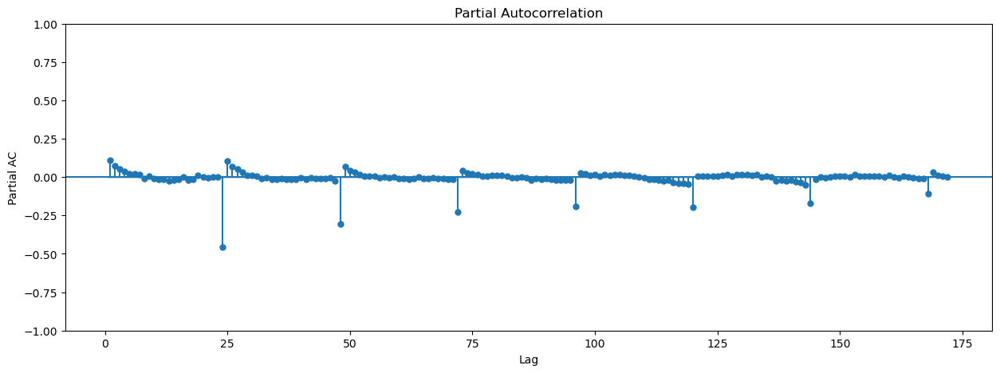

In [161]:
plt.figure(figsize=(15, 5))
plot_pacf(df_hourly_brooklyn["hourly_difference"], lags=172, ax=plt.gca(), method='ywm', alpha=0.05, zero=False)
plt.xlabel('Lag')
plt.ylabel('Partial AC')
plt.show()

Here I am choosing 172 lags to look at. This is derived from the EDA notebook where we saw deviation from the mean in terms of hour of the day and day of the week, but less in terms of month of the year and year in general. So 172 lags is a week (in terms of hours) and a little bit.

In [165]:
# 168 hours is a week, plus 4 incase there is some significance a bit after
pcaf_brooklyn = stattools.pacf(train, nlags=172, method='ywadjusted').tolist()

In [179]:
confidence_interval = 0.08
p_params = [index for index, pcaf_brooklyn in enumerate(pcaf_brooklyn) if not(-confidence_interval < pcaf_brooklyn < confidence_interval)]
p_params.pop(0)
print(p_params)
print(len(p_params))

[1, 2, 9, 10, 11, 12, 13, 16, 21, 22, 23, 24, 34, 40, 48, 64, 72, 120, 136, 144, 168]
21


In [180]:
model = SARIMAX(train, order=(p_params, 0, 0), trend="c")
model_fit = model.fit(disp=0)

model_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                                                        SARIMAX Results                                                                         
================================================================================================================================================================
Dep. Variable:                                                                                                 BROOKLYN   No. Observations:                 2208
Model:             SARIMAX([1, 2, 9, 10, 11, 12, 13, 16, 21, 22, 23, 24, 34, 40, 48, 64, 72, 120, 136, 144, 168], 0, 0)   Log Likelihood               -6926.948
Date:                                                                                                  Sun, 23 Jun 2024   AIC                          13899.896
Time:                                                                                                          18:37:39   BIC                          14030.992
Sample:                                                                                                      10-01-2023   HQIC                         13947.791
                                                                                                           - 12-31-2023                                         
Covariance Type:                                                                                                    opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.0891      1.430      0.761      0.446      -1.714       3.892
ar.L1          0.1103      0.018      6.192      0.000       0.075       0.145
ar.L2          0.0865      0.019      4.542      0.000       0.049       0.124
ar.L9          0.0007      0.018      0.040      0.968      -0.034       0.035
ar.L10         0.0115      0.021      0.556      0.579      -0.029       0.052
ar.L11        -0.0186      0.019     -0.982      0.326      -0.056       0.019
ar.L12        -0.0098      0.020     -0.504      0.614      -0.048       0.028
ar.L13        -0.0207      0.019     -1.100      0.271      -0.058       0.016
ar.L16         0.0088      0.020      0.446      0.656      -0.030       0.047
ar.L21        -0.0008      0.018     -0.042      0.967      -0.036       0.035
ar.L22         0.0047      0.019      0.242      0.808      -0.033       0.043
ar.L23         0.0559      0.019      2.883      0.004       0.018       0.094
ar.L24         0.1532      0.021      7.371      0.000       0.112       0.194
ar.L34        -0.0576      0.020     -2.853      0.004      -0.097      -0.018
ar.L40         0.0089      0.021      0.430      0.668      -0.032       0.049
ar.L48         0.0899      0.020      4.462      0.000       0.050       0.129
ar.L64         0.0235      0.021      1.143      0.253      -0.017       0.064
ar.L72         0.0944      0.021      4.580      0.000       0.054       0.135
ar.L120        0.0778      0.021      3.731      0.000       0.037       0.119
ar.L136        0.0539      0.020      2.692      0.007       0.015       0.093
ar.L144        0.1236      0.021      5.925      0.000       0.083       0.164
ar.L168        0.1572      0.022      7.297      0.000       0.115       0.199
sigma2        30.9687      0.882     35.131      0.000      29.241      32.696
===================================================================================
Ljung-Box (L1) (Q):                   0.36   Jarque-Bera (JB):                39.62
Prob(Q):                              0.55   Prob(JB):                         0.00
Heteroskedasticity (H):               0.99   Skew:                             0.26
Prob(H) (two-sided):                  0.92   Kurtosis:                         3.39
=============================

In [181]:
predictions = model_fit.predict(start=0, end=len(train)+len(test)-1)

In [182]:
predictions.head()

2023-10-01 00:00:00    23.238537
2023-10-01 01:00:00    25.019718
2023-10-01 02:00:00    26.544562
2023-10-01 03:00:00    23.225088
2023-10-01 04:00:00    20.452588
Freq: H, Name: predicted_mean, dtype: float64

In [183]:
test.index

DatetimeIndex(['2024-01-01 00:00:00', '2024-01-01 01:00:00',
               '2024-01-01 02:00:00', '2024-01-01 03:00:00',
               '2024-01-01 04:00:00', '2024-01-01 05:00:00',
               '2024-01-01 06:00:00', '2024-01-01 07:00:00',
               '2024-01-01 08:00:00', '2024-01-01 09:00:00',
               ...
               '2024-01-31 15:00:00', '2024-01-31 16:00:00',
               '2024-01-31 17:00:00', '2024-01-31 18:00:00',
               '2024-01-31 19:00:00', '2024-01-31 20:00:00',
               '2024-01-31 21:00:00', '2024-01-31 22:00:00',
               '2024-01-31 23:00:00', '2024-02-01 00:00:00'],
              dtype='datetime64[ns]', length=745, freq='H')

In [203]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=train, mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=test, mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=predictions.index, y=predictions, mode='lines', name="Predictions"))
fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Difference (billions)", 
    xaxis_title="Date",
    title="Change in Revenue Passenger Miles over Prior Year"
)
fig.show()

In [185]:
train_mape = mean_absolute_percentage_error(train, predictions[train.index])
test_mape = mean_absolute_percentage_error(test, predictions[test.index])

print(f"Train MAPE on the difference: {round(train_mape, 2)}%")
print(f"Test MAPE on the difference: {round(test_mape, 2)}%")

Train MAPE on the difference: 21.97%
Test MAPE on the difference: 23.95%


**CURRENT STOP:** Stopping here as need to optomize model above so it runs faster and can run across the entire dataset. This is why I am having trouble adding back in differencing and trend back to the dataset below. This issue should be resolved when running model over full train and test index.

We now have our unadjusted base model, with a MAPE of 23.95% as compared to the baseline of 38.8%. Much better but we can see that as the model predicts farther into the future the score gets worse. Thats okay it just means that to have the best model keeping the data current will be important for predictive accuracy.

Next, we need to add back in our trend and seasonality.

In [213]:
df_hourly_brooklyn.head(30)

,BROOKLYN,hourly_difference,Trend,Seasonal,Residual,restored,AR_difference,AR_restored
2018-01-02 00:00:00,18,-19.0,NaN,0.003379,NaN,18.0,NaN,18.0
2018-01-02 01:00:00,8,-20.0,NaN,0.001021,NaN,8.0,NaN,8.0
2018-01-02 02:00:00,9,-25.0,NaN,0.003808,NaN,9.0,NaN,9.0
2018-01-02 03:00:00,7,-7.0,NaN,-0.000934,NaN,7.0,NaN,7.0
2018-01-02 04:00:00,3,-16.0,NaN,0.001213,NaN,3.0,NaN,3.0
2018-01-02 05:00:00,8,-11.0,NaN,-0.000103,NaN,8.0,NaN,8.0
2018-01-02 06:00:00,6,-10.0,NaN,-0.001126,NaN,6.0,NaN,6.0
2018-01-02 07:00:00,17,9.0,NaN,-0.002552,NaN,17.0,NaN,17.0
2018-01-02 08:00:00,12,2.0,NaN,0.005599,NaN,12.0,NaN,12.0
2018-01-02 09:00:00,15,3.0,NaN,-0.003475,NaN,15.0,NaN,15.0


In [211]:
# we slice out the first 24 hours and the rest of the dates
first_day_indices = df_hourly_brooklyn.index[:24]
remaining_indices = df_hourly_brooklyn.index[24:]

# create an empty restored column
df_hourly_brooklyn["restored"] = np.nan

# fill in the first 24 original values into the empty restored column
df_hourly_brooklyn.loc[first_day_indices, "restored"] = \
    df_hourly_brooklyn.loc[first_day_indices, "BROOKLYN"]

# use the current difference value and 24-hour lagged restored value to get the next restored value
for current_date in remaining_indices:
    current_value = df_hourly_brooklyn.loc[current_date, "hourly_difference"]
    day_before_restored = df_hourly_brooklyn.loc[current_date - pd.DateOffset(hours=24), "restored"]
    
    df_hourly_brooklyn.loc[current_date, "restored"] = day_before_restored + current_value

# check agreement everywhere (rounding errors can come up so check closeness rather than strict equality)
np.allclose(df_hourly_brooklyn["BROOKLYN"], df_hourly_brooklyn["restored"])

True

In [214]:
# use the original train diff values and predicted test values
df_hourly_brooklyn.loc[train.index, "AR_difference"] = df_hourly_brooklyn.loc[train.index, "hourly_difference"]
df_hourly_brooklyn.loc[test.index, "AR_difference"] = predictions[test.index]
df_hourly_brooklyn.head(25)

,BROOKLYN,hourly_difference,Trend,Seasonal,Residual,restored,AR_difference,AR_restored
2018-01-02 00:00:00,18,-19.0,NaN,0.003379,NaN,18.0,NaN,18.0
2018-01-02 01:00:00,8,-20.0,NaN,0.001021,NaN,8.0,NaN,8.0
2018-01-02 02:00:00,9,-25.0,NaN,0.003808,NaN,9.0,NaN,9.0
2018-01-02 03:00:00,7,-7.0,NaN,-0.000934,NaN,7.0,NaN,7.0
2018-01-02 04:00:00,3,-16.0,NaN,0.001213,NaN,3.0,NaN,3.0
2018-01-02 05:00:00,8,-11.0,NaN,-0.000103,NaN,8.0,NaN,8.0
2018-01-02 06:00:00,6,-10.0,NaN,-0.001126,NaN,6.0,NaN,6.0
2018-01-02 07:00:00,17,9.0,NaN,-0.002552,NaN,17.0,NaN,17.0
2018-01-02 08:00:00,12,2.0,NaN,0.005599,NaN,12.0,NaN,12.0
2018-01-02 09:00:00,15,3.0,NaN,-0.003475,NaN,15.0,NaN,15.0


We then repate the same process above but for the original counts.

In [199]:
# empty restored column
df_hourly_brooklyn["AR_restored"] = np.nan

# fill in the first 12 original values
df_hourly_brooklyn.loc[first_year_indices, "AR_restored"] = \
    df_hourly_brooklyn.loc[first_year_indices, "BROOKLYN"]


# use the current difference and 12-month lagged restored value to get the next restored
for current_date in remaining_indices:
    current_value = df_hourly_brooklyn.loc[current_date, "AR_difference"]
    day_before_restored = df_hourly_brooklyn.loc[current_date - pd.DateOffset(hours=24), "AR_restored"]
    
    df_hourly_brooklyn.loc[current_date, "AR_restored"] = day_before_restored + current_value

In [202]:
df_hourly_brooklyn.tail(25)

,BROOKLYN,hourly_difference,Trend,Seasonal,Residual,restored,AR_difference,AR_restored
2024-03-30 23:00:00,22,3.0,-2.958333,0.003168,5.955165,22.0,NaN,NaN
2024-03-31 00:00:00,33,3.0,-2.208333,0.003379,5.204955,33.0,NaN,NaN
2024-03-31 01:00:00,18,-13.0,-1.604167,0.001021,-11.396854,18.0,NaN,NaN
2024-03-31 02:00:00,25,3.0,-1.416667,0.003808,4.412859,25.0,NaN,NaN
2024-03-31 03:00:00,12,-4.0,-1.020833,-0.000934,-2.978232,12.0,NaN,NaN
2024-03-31 04:00:00,13,2.0,0.354167,0.001213,1.644620,13.0,NaN,NaN
2024-03-31 05:00:00,15,0.0,1.354167,-0.000103,-1.354064,15.0,NaN,NaN
2024-03-31 06:00:00,10,-4.0,0.916667,-0.001126,-4.915540,10.0,NaN,NaN
2024-03-31 07:00:00,17,9.0,0.666667,-0.002552,8.335885,17.0,NaN,NaN
2024-03-31 08:00:00,30,10.0,0.708333,0.005599,9.286068,30.0,NaN,NaN


In [206]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=train.index, y=df_hourly_brooklyn.loc[train.index, "BROOKLYN"], mode='lines', name="Train"))
fig.add_trace(go.Scatter(x=test.index, y=df_hourly_brooklyn.loc[test.index, "BROOKLYN"], mode='lines', name="Test"))
fig.add_trace(go.Scatter(x=test.index, y=df_hourly_brooklyn.loc[test.index, "AR_restored"], mode='lines', name="AR prediction"))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title="Passenger-miles (billions)", 
    xaxis_title="Date",
    title="Revenue Passenger Miles over Prior Year"
)
fig.show()